<h1><center>Capstone project - 1</center></h1>

This notebook is created as a part of Capstone project submission by Group 1034. The notebook will give a clear picture on how the EDA was done and some of those are recommended.

## Table of content

1. [Importing libraries](#section1)
2. [Loading datasets](#section2)
3. [Data summary](#section3)
4. [Missing values](#section4)<br>
    4.1. [Missing state values](#section4_1)<br>
    4.2. [Missing latitude and longitude values](#section4_2)<br>
    4.3. [Missing device_id values](#section4_3)<br>
5. [Cleanup and merge dataset](#section5)
6. [Observations](#section6)<br>
    6.1. [Distribution of users across state](#section6_1)<br>
    6.2. [Distribution of users across phone brand(top 10)](#section6_2)<br>
    6.3. [Distribution of users across gender](#section6_3)<br>
    6.4. [Distribution of users across age segment](#section6_4)<br>
    6.5. [Distribution of phone brand(top 10) for each age segment, state and gender](#section6_5)<br>
    6.6. [Distribution of gender for each state, age segment and phone brand(top 10)](#section6_6)<br>
    6.7. [Distribution of age segment for each state, gender and phone brand(top 10)](#section6_7)<br>
    6.8. [Hourly distribution of phone calls](#section6_8)<br>
    6.9. [Users distribution on Map](#section6_9)<br>
7. [Conclusion](#section7)

<a id="section1"></a> 

## 1. Importing libraries

Importing the necessary libraries for this project

In [1]:
import pandas as pd
import mysql.connector
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import folium
from folium.plugins import MarkerCluster

<a id="section2"></a>

## 2. Loading datasets

Fetching gender and phone brand data from MySQL connection

In [2]:
# establishing a connection to the remote MySQL server
conn = mysql.connector.connect(user='student', password='student', host='cpanel.insaid.co', database='Capstone1')

# fetching the dataset onto a data frame
gender = pd.read_sql('SELECT * FROM gender_age_train', con=conn)
brand = pd.read_sql('SELECT * FROM phone_brand_device_model', con=conn)

# loading events data from csv file
events = pd.read_csv('events_data.csv')

<a id="section3"></a>

## 3. Data summary

A summary of the datasets loaded in the notebook

In [3]:
events.shape

(3252950, 7)

In [4]:
events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3252950 entries, 0 to 3252949
Data columns (total 7 columns):
event_id     float64
device_id    float64
timestamp    object
longitude    float64
latitude     float64
city         object
state        object
dtypes: float64(4), object(3)
memory usage: 173.7+ MB


In [5]:
events['timestamp'] = pd.to_datetime(events['timestamp'])

In [6]:
gender.shape

(74645, 4)

In [7]:
gender.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 74645 entries, 0 to 74644
Data columns (total 4 columns):
device_id    74645 non-null int64
gender       74645 non-null object
age          74645 non-null int64
group        74645 non-null object
dtypes: int64(2), object(2)
memory usage: 2.3+ MB


In [8]:
brand.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 87726 entries, 0 to 87725
Data columns (total 3 columns):
device_id       87726 non-null int64
phone_brand     87726 non-null object
device_model    87726 non-null object
dtypes: int64(1), object(2)
memory usage: 2.0+ MB


In [9]:
brand.shape

(87726, 3)

There are 3252950 events in total, 74645 gender records and 87726 phone brand records

<a id="section4"></a>

## 4. Missing values

Checking for null values in all three datasets

In [10]:
events.isnull().sum()

event_id       0
device_id    453
timestamp      0
longitude    423
latitude     423
city           0
state        377
dtype: int64

In [11]:
gender.isnull().sum()

device_id    0
gender       0
age          0
group        0
dtype: int64

In [12]:
brand.isnull().sum()

device_id       0
phone_brand     0
device_model    0
dtype: int64

<a id="section4_1"></a>

### 4.1 Missing state values

In [13]:
def replace_missing_state(df):
    missing_state_city = df[df['state'].isnull()]['city'].unique()
    missing_state = []
    for city in missing_state_city:
        missing_state.append(df.loc[df['city'] == city]['state'].unique()[0])
    for i in range(0, len(missing_state)):
        cond = (df['city'] == missing_state_city[i])
        df.loc[cond, 'state'] = df.loc[cond, 'state'].fillna(missing_state[i])
    print('Missing state count: ' + str(df.state.isnull().sum()))

In [14]:
replace_missing_state(events)

Missing state count: 0


As we have filled all the data with the respective states, we will filter the events data to get only the states that are in scope of this project

In [15]:
df = events[events['state'].isin(['Rajasthan', 'UttarPradesh', 'Haryana', 'Jharkhand', 'Orissa', 'Telangana', 'Assam'])]
df.shape

(370982, 7)

<a id="section4_2"></a>

### 4.2 Missing latitude and longitude values

We will find the records missing latitude and longitude

In [16]:
missing_lat = df[df['latitude'].isnull()][['event_id', 'city']]
missing_long = df[df['longitude'].isnull()][['event_id', 'city']]

In [17]:
print(missing_lat.shape)
print(missing_long.shape)

(66, 2)
(66, 2)


In [18]:
for i in range(0, 66):
    df.loc[df['event_id'] == missing_lat.iloc[i, 0], 'latitude'] = df[df['city'] == missing_lat.iloc[i, 1]]['latitude'].mean()
    df.loc[df['event_id'] == missing_long.iloc[i, 0], 'longitude'] = df[df['city'] == missing_long.iloc[i, 1]]['longitude'].mean()

//anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


<a id="section4_3"></a>

### 4.3 Missing device_id values

Since we don't have any reference to fill the device ID, we will remove the records having missing device_id values

In [19]:
df.dropna(inplace=True)
df.isnull().sum()

//anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

<a id="section5"></a>

## 5. Cleanup and merge dataset

We have brand names in other languages. Will replace those with english names

In [20]:
brand_name_og = ['华为','小米','三星','魅族','酷派','乐视','联想 ', '努比亚']
brand_name_en = ['Huawei','Xiaomi','Samsung','Meizu','Coolpad','LeEco','Lenovo', 'Nubia']
for i in range(0, 8):
    brand['phone_brand'] = brand['phone_brand'].replace(brand_name_og[i], brand_name_en[i])

Since there was a problem with the overall dataset, we are using the dataset provided by INSAID

In [21]:
df = pd.read_csv('events_data_1034.csv')
df.isnull().sum()

event_id      0
device_id     0
timestamp     0
longitude     0
latitude      0
city          0
state        49
dtype: int64

In [22]:
replace_missing_state(df)

Missing state count: 0


In [23]:
df = df[df['state'].isin(['Rajasthan', 'UttarPradesh', 'Haryana', 'Jharkhand', 'Orissa', 'Telangana', 'Assam'])]
df.shape

(370982, 7)

In [24]:
df.isnull().sum()

event_id     0
device_id    0
timestamp    0
longitude    0
latitude     0
city         0
state        0
dtype: int64

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 370982 entries, 0 to 370981
Data columns (total 7 columns):
event_id     370982 non-null int64
device_id    370982 non-null int64
timestamp    370982 non-null object
longitude    370982 non-null float64
latitude     370982 non-null float64
city         370982 non-null object
state        370982 non-null object
dtypes: float64(2), int64(2), object(3)
memory usage: 22.6+ MB


In [26]:
df['timestamp'] = pd.to_datetime(df['timestamp'])

We will check for incorrect latitude and longitude values by plotting it in map

In [27]:
temp = df.groupby([
    'device_id',
    'longitude',
    'latitude',
    'city',
    'state'
]).count().reset_index()

In [28]:
temp.shape

(12500, 7)

In [29]:
def draw_map(df):
    map = folium.Map(location=[22.735657, 77.958985], zoom_start=5)
    cluster = MarkerCluster()
    cluster.add_to(map)
    for index, row in df.iterrows():
        cluster.add_child(folium.Marker(location=[row.latitude, row.longitude], tooltip=str(row['latitude']) + ', ' + str(row['longitude']), popup=row['device_id']))
    return map

In [30]:
draw_map(temp)

We will fetch the records which has values outlying to the latitude and longitude values of India

In [31]:
temp[(8.4 > temp['latitude']) | (temp['latitude'] > 37.6)]

,device_id,longitude,latitude,city,state,event_id,timestamp
6404,305848775386534942,0.0000,0.0000,Jaipur,Rajasthan,22,22
9188,4375039830232870086,0.0000,0.0000,Jaipur,Rajasthan,22,22
9336,4580179444377397556,0.0000,0.0000,Jaipur,Rajasthan,22,22
9430,4718752803626400936,12.5674,41.8719,Jaipur,Rajasthan,3,3


In [32]:
wrong_val = temp[(68.7 > temp['longitude']) | (temp['longitude'] > 97.25)][['device_id', 'latitude', 'longitude', 'city']]
wrong_val

,device_id,latitude,longitude,city
4828,-1926548054995953581,25.2048,55.2708,Bari
6404,305848775386534942,0.0000,0.0000,Jaipur
9188,4375039830232870086,0.0000,0.0000,Jaipur
9336,4580179444377397556,0.0000,0.0000,Jaipur
9430,4718752803626400936,41.8719,12.5674,Jaipur


Since we have all the data of latitude in longitude missing values, we will consider that for replacing the data with correct value

In [33]:
def mean_lat_long_value(df, row):
    cond = ((df['device_id'] == row['device_id']) & (df['latitude'] == row['latitude']) & (df['longitude'] == row['longitude']))
    temp_rec = df[df.city == row['city']][['latitude', 'longitude']].mean()
    df.loc[cond, 'latitude'] = temp_rec['latitude']
    df.loc[cond, 'longitude'] = temp_rec['longitude']

In [34]:
for i, row in wrong_val.iterrows():
    mean_lat_long_value(df, row)

From the map above, we can see that there's another record (deviceId = -3693510914308259877) which lies outside India but lies between the range we filtered. So will replace the value for that record

In [35]:
wrong_val = temp[temp['device_id'] == -3693510914308259877][['device_id', 'latitude', 'longitude', 'city']]
wrong_val

,device_id,latitude,longitude,city
3674,-3693510914308259877,34.555300,69.207500,Jaipur
3675,-3693510914308259877,26.984489,75.810233,Jaipur


In [36]:
cond = ((df['device_id'] == -3693510914308259877) & (df['latitude'] == 34.555300) & (df['longitude'] == 69.207500))
df.loc[cond, 'latitude'] = 26.984489
df.loc[cond, 'longitude'] = 75.810233

Calculating the unique values again and plotting to confirm there are no invalid records

In [37]:
temp = df.groupby([
    'device_id',
    'longitude',
    'latitude',
    'city',
    'state'
]).count().reset_index()

In [38]:
draw_map(temp)

Exporting the final clean data for uploading into the dashboard

In [39]:
temp = df[['event_id', 'device_id', 'timestamp', 'longitude', 'latitude', 'state']]
temp.to_csv('final_data.csv', index=False)

#### Merging the data

In [40]:
temp_df = pd.merge(gender, brand, how='inner', on='device_id')
temp_df.shape

(74617, 6)

In [41]:
merged_df = pd.merge(df, temp_df, how='inner', on='device_id')
merged_df.shape

(370901, 12)

In [42]:
merged_df.head()

,event_id,device_id,timestamp,longitude,latitude,city,state,gender,age,group,phone_brand,device_model
0,616897,4112232520748712732,2016-05-06 23:07:41,78.566758,17.481422,Hyderabad,Telangana,M,23,M23-26,Xiaomi,小米4C
1,2699320,4112232520748712732,2016-05-04 12:34:38,78.566758,17.481422,Hyderabad,Telangana,M,23,M23-26,Xiaomi,小米4C
2,3232372,4112232520748712732,2016-05-04 11:08:31,78.566758,17.481422,Hyderabad,Telangana,M,23,M23-26,Xiaomi,小米4C
3,617054,8845954542270213082,2016-05-07 23:34:30,78.493221,17.476113,Hyderabad,Telangana,M,22,M22-,vivo,X5Pro
4,1440290,8845954542270213082,2016-05-07 23:31:37,78.493221,17.476113,Hyderabad,Telangana,M,22,M22-,vivo,X5Pro


<a id="section6"></a>

## 6. Observations

We will create a dataframe with unique user value to find the distribution

In [43]:
unique_set = merged_df.groupby([
    'device_id', 
    'longitude', 
    'latitude', 
    'city', 
    'state', 
    'gender',
    'age',
    'group',
    'phone_brand'
]).count().reset_index()

In [44]:
unique_set.shape

(12496, 12)

<a id="section6_1"></a>

### 6.1 Distribution of users across state

Text(0, 0.5, 'No. of users')

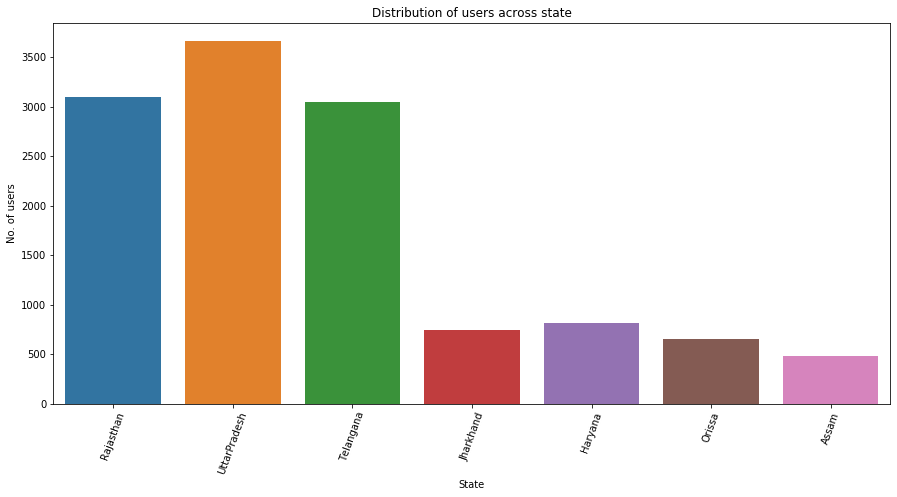

In [45]:
plt.figure(figsize=(15, 7))
user_state_plot = sns.countplot('state', data=unique_set)
plt.xticks(rotation=70)
plt.title('Distribution of users across state')
plt.xlabel('State')
plt.ylabel('No. of users')

<a id="section6_2"></a>

### 6.2 Distribution of users across phone brand (top 10)

In [46]:
temp = unique_set.groupby('phone_brand')['device_id'].count().sort_values(ascending=False)
top10Phone = temp.head(10).reset_index()
temp.head(10)

phone_brand
Xiaomi     3129
Samsung    2785
Huawei     2068
vivo       1116
OPPO        935
Meizu       774
Coolpad     582
HTC         203
Lenovo      137
Nubia        94
Name: device_id, dtype: int64

Text(0, 0.5, 'No. of users')

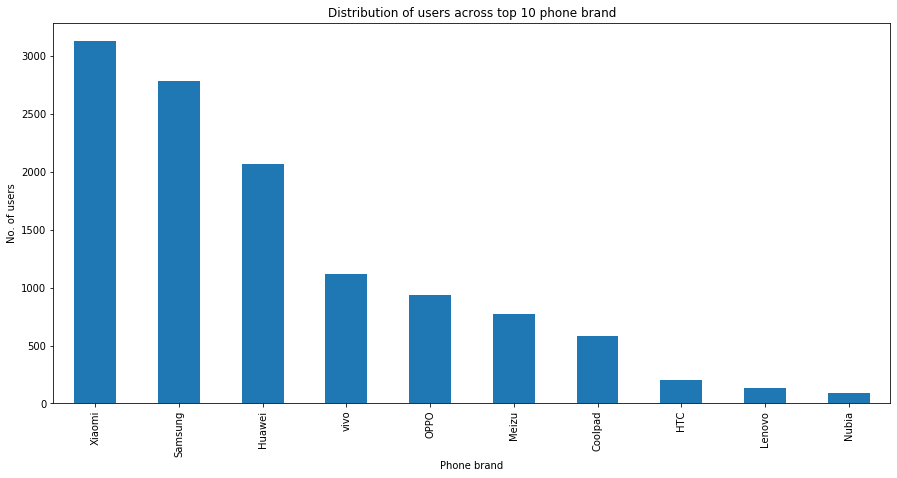

In [47]:
temp.head(10).plot(kind='bar', figsize=(15,7))
plt.title('Distribution of users across top 10 phone brand')
plt.xlabel('Phone brand')
plt.ylabel('No. of users')

<a id="section6_3"></a>

### 6.3 Distribution of users across gender

Text(0.5, 0, 'No. of users')

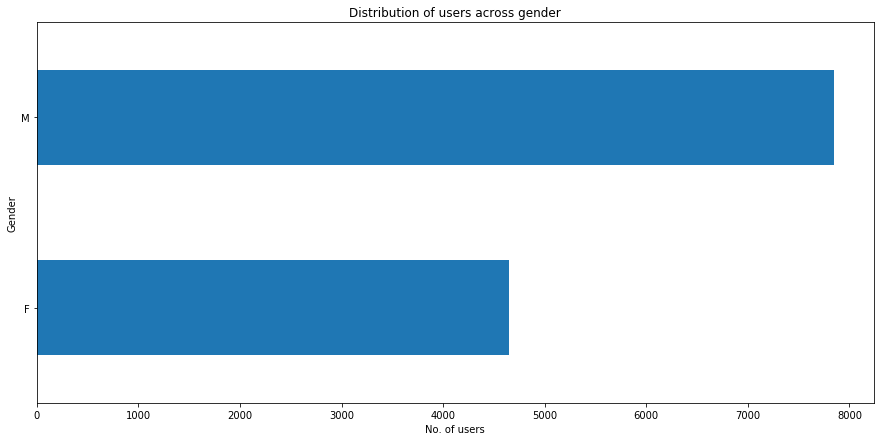

In [48]:
temp = unique_set.groupby('gender')['device_id'].count()
temp.plot.barh(x='gender', y='value', figsize=(15,7))
plt.title('Distribution of users across gender')
plt.ylabel('Gender')
plt.xlabel('No. of users')

<a id="section6_4"></a>

### 6.4 Distribution of users across age segment

Text(0, 0.5, 'No. of users')

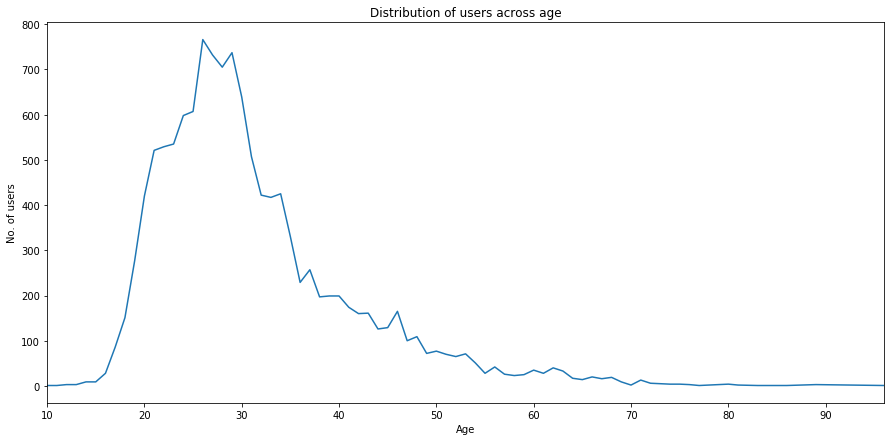

In [49]:
temp = unique_set.groupby('age')['device_id'].count()
temp.plot(kind='line', figsize=(15, 7))
plt.title('Distribution of users across age')
plt.xlabel('Age')
plt.ylabel('No. of users')

Text(0, 0.5, 'No. of users')

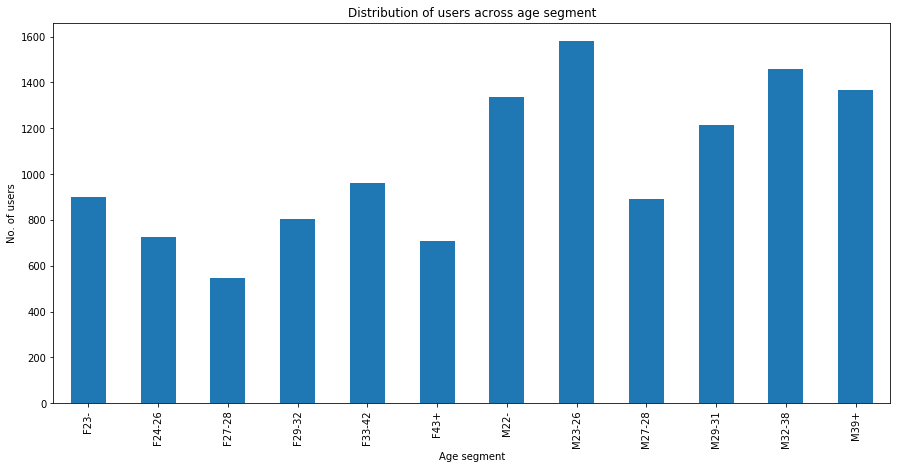

In [50]:
temp = unique_set.groupby('group')['device_id'].count()
temp.plot(kind='bar', figsize=(15,7))
plt.title('Distribution of users across age segment')
plt.xlabel('Age segment')
plt.ylabel('No. of users')

<a id="section6_5"></a>

### 6.5 Distribution of phone brand (top 10) for each age segment, state and gender

Filtering the dataset to get the data of top 10 phone brand

In [51]:
top_brand = top10Phone['phone_brand'].to_list()
phone_brand_filter = unique_set[unique_set['phone_brand'].isin(top_brand)]
phone_brand_filter.shape

(11823, 12)

#### Phone brand across age segment

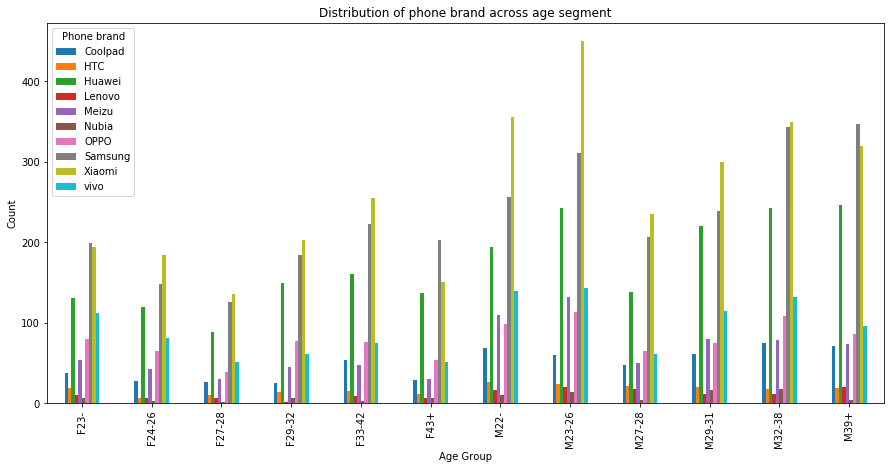

In [52]:
temp = phone_brand_filter.groupby(['phone_brand', 'group']).size().reset_index().pivot(columns='phone_brand', index='group', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of phone brand across age segment')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.legend(title='Phone brand')

#### Phone brand across gender

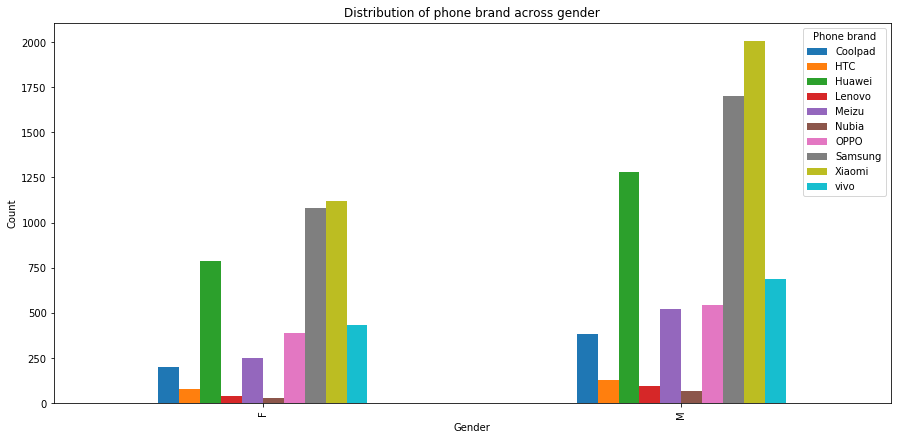

In [53]:
temp = phone_brand_filter.groupby(['phone_brand', 'gender']).size().reset_index().pivot(columns='phone_brand', index='gender', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of phone brand across gender')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.legend(title='Phone brand')

#### Phone brand across state

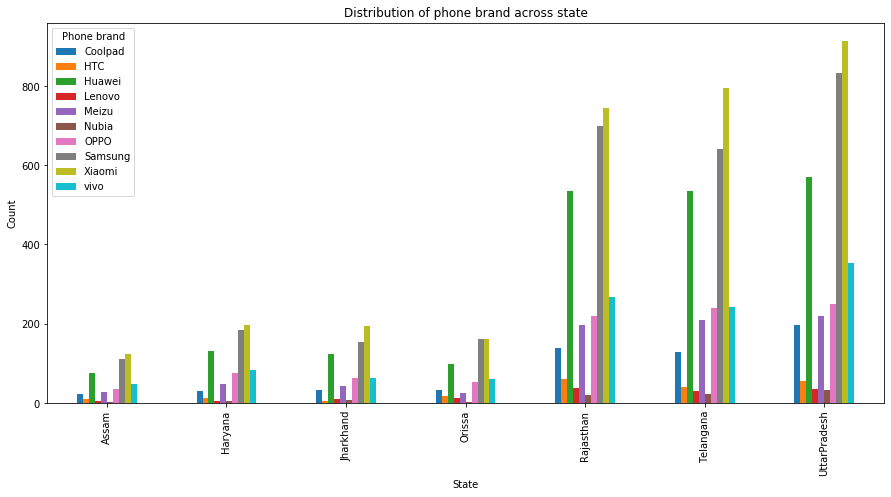

In [54]:
temp = phone_brand_filter.groupby(['phone_brand', 'state']).size().reset_index().pivot(columns='phone_brand', index='state', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of phone brand across state')
plt.xlabel('State')
plt.ylabel('Count')
plt.legend(title='Phone brand')

<a id="section6_6"></a>

### 6.6 Distribution of gender for each state, age segment and phone brand (top 10)

#### Gender across state

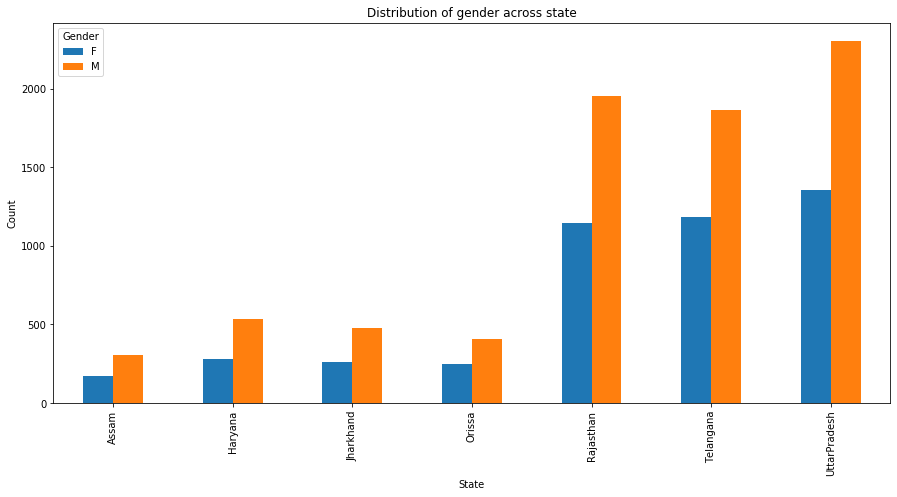

In [55]:
temp = unique_set.groupby(['gender', 'state']).size().reset_index().pivot(columns='gender', index='state', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of gender across state')
plt.xlabel('State')
plt.ylabel('Count')
plt.legend(title='Gender')

#### Gender across age segment

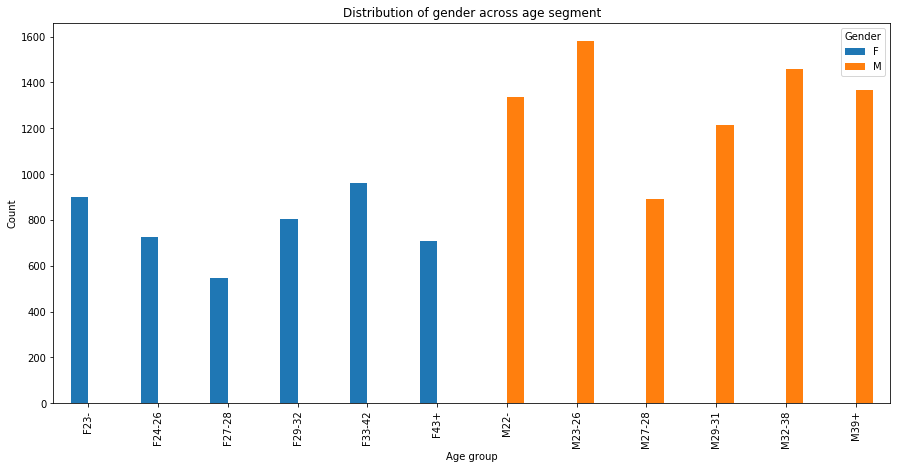

In [56]:
temp = unique_set.groupby(['gender', 'group']).size().reset_index().pivot(columns='gender', index='group', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of gender across age segment')
plt.xlabel('Age group')
plt.ylabel('Count')
plt.legend(title='Gender')

#### Gender across phone brand

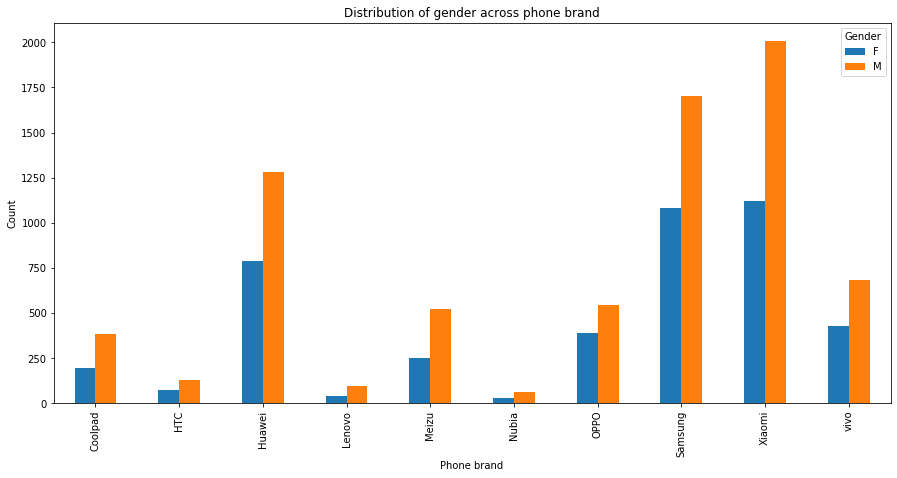

In [57]:
temp = phone_brand_filter.groupby(['gender', 'phone_brand']).size().reset_index().pivot(columns='gender', index='phone_brand', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of gender across phone brand')
plt.xlabel('Phone brand')
plt.ylabel('Count')
plt.legend(title='Gender')

<a id="section6_7"></a>

### 6.7 Distribution of age segment for each state, gender and phone brand (top 10)

#### Age segment across state

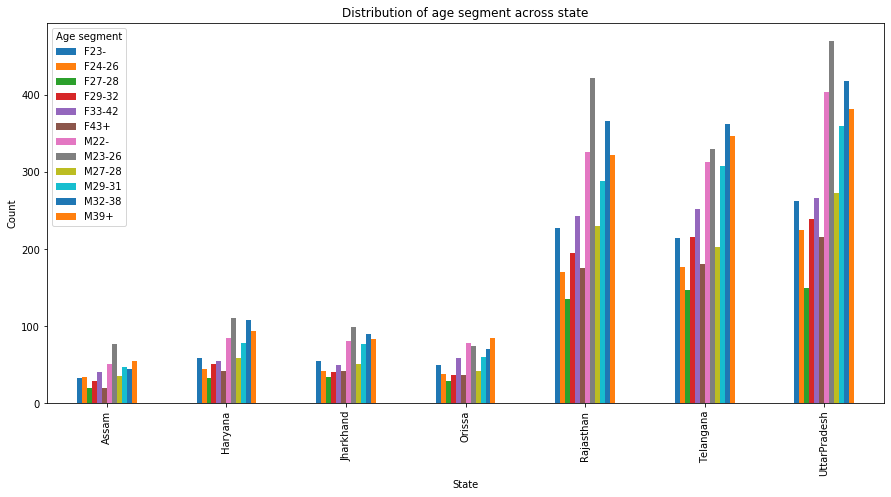

In [58]:
temp = unique_set.groupby(['group', 'state']).size().reset_index().pivot(columns='group', index='state', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of age segment across state')
plt.xlabel('State')
plt.ylabel('Count')
plt.legend(title='Age segment')

#### Age segment across gender

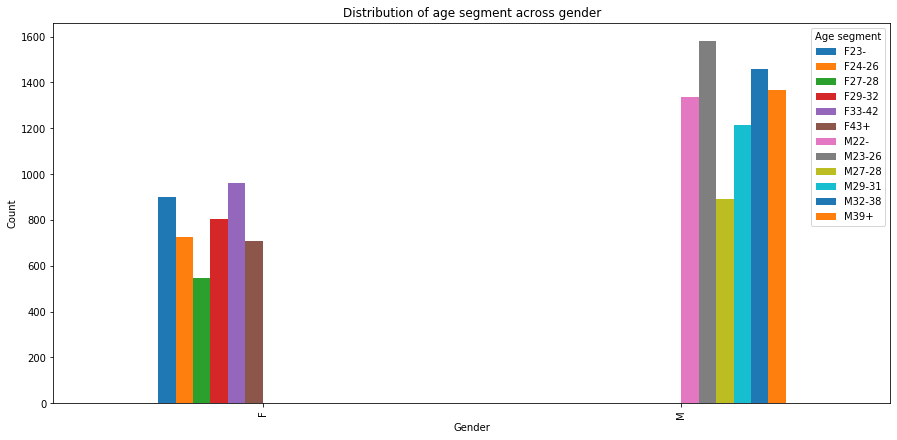

In [59]:
temp = unique_set.groupby(['group', 'gender']).size().reset_index().pivot(columns='group', index='gender', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of age segment across gender')
plt.xlabel('Gender')
plt.ylabel('Count')
plt.legend(title='Age segment')

#### Age segment across phone brand

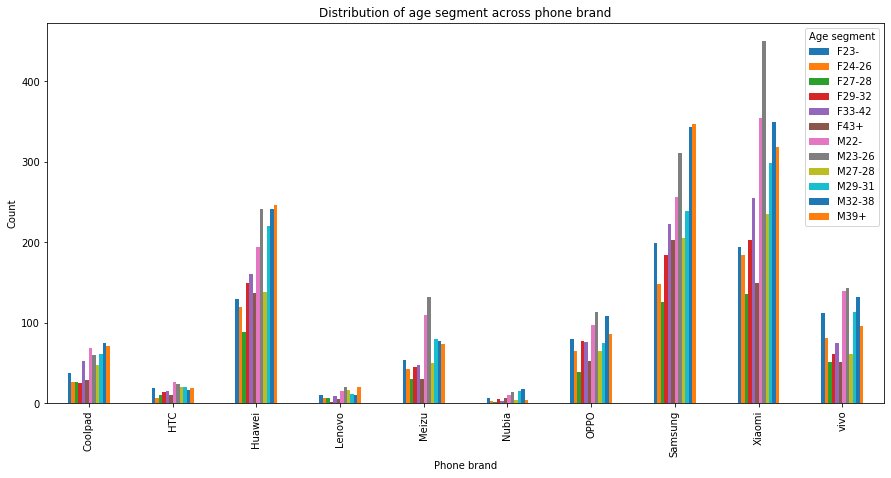

In [60]:
temp = phone_brand_filter.groupby(['group', 'phone_brand']).size().reset_index().pivot(columns='group', index='phone_brand', values=0)
temp.plot.bar(figsize=(15, 7))
plt.title('Distribution of age segment across phone brand')
plt.xlabel('Phone brand')
plt.ylabel('Count')
plt.legend(title='Age segment')

<a id="section6_8"></a>

### 6.8 Hourly distribution of phone calls

Text(0.5, 0, 'Hours')

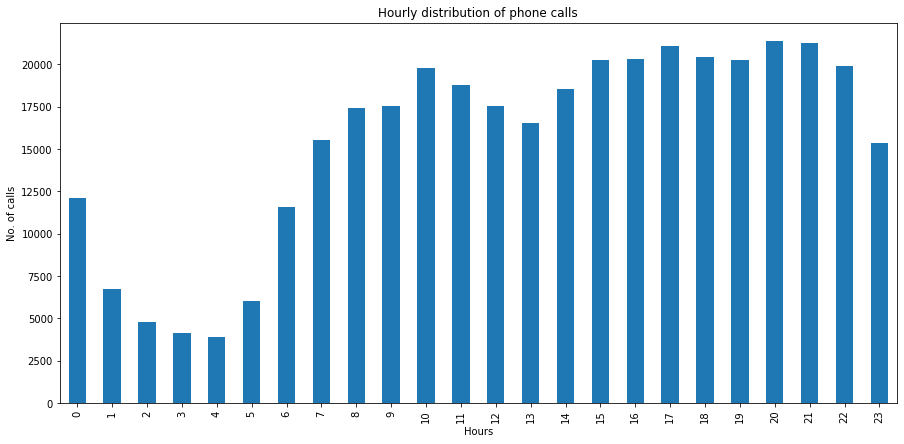

In [61]:
merged_df['hour'] = merged_df.timestamp.dt.hour
temp = merged_df.groupby('hour')['device_id'].count()
temp.plot(kind='bar', x='hour', figsize=(15, 7))
plt.title('Hourly distribution of phone calls')
plt.xticks(temp.keys())
plt.ylabel('No. of calls')
plt.xlabel('Hours')

<a id="section6_9"></a>

### 6.9 Users distribution on map

In [62]:
draw_map(unique_set)

<a id="section7"></a>

## 7. Conclusion

Based on the above exploration of the data, we have some proposed solution. 

They are below.

1. Based on the hourly distribution of phone calls, the calls are low in the range 12:00 AM to 6:00 AM. We could offer free calls or rate cutter plans to the customer to increase the activities in this hour range
2. Based on the phone brand distribution, Xiaomi has more number of users across all the states. so InsaidTelecom could tie-up with Xiaomi to boost up their market and increase customer base
3. Based on the gender distribution, the number of female customer is less compared to male. So InsaidTelecom can come up with a plan to increase the female customer base too.